In [ ]:
#%matplotlib inline 
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
import math
from datetime import datetime as dt
from datetime import timedelta

import seaborn as sns
import statsmodels.api as sm
import scipy.optimize as sco
import scipy.interpolate as sci
import math

plt.style.use(style ='seaborn')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from statsmodels.tsa.arima_model import ARMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

data = pd.read_csv('/content/drive/MyDrive/Data/Bike_Sharing/data_final.csv')
data = data.drop(data.columns[0], axis =1)
data['timestamp'] = data['timestamp'].apply(pd.to_datetime, format='%Y-%m-%d %H:%M:%S.%f')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
all_stations_demand = data.set_index('timestamp')
all_stations_demand

,A.I. Virtasen aukio,"Aalto-yliopisto (M), Korkeakouluaukio","Aalto-yliopisto (M), Tietotie",Abraham Wetterin tie,Agnetankuja,Agronominkatu,Ahertajantie,Alakiventie,Albertinkatu,Annankatu,...,Viikin normaalikoulu,Viikin tiedepuisto,Viiskulma,Vilhonvuorenkatu,Voikukantie,Von Daehnin katu,Westendinasema,Westendintie,Yhdyskunnankuja,Ympyrätalo
timestamp,,,,,,,,,,,,,,,,,,,,,
2016-05-02 15:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
2016-05-02 16:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6
2016-05-02 17:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
2016-05-02 18:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,10
2016-05-02 19:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-31 20:00:00,0,2,0,0,0,0,0,0,1,0,...,0,1,4,0,0,0,1,0,0,2
2020-10-31 21:00:00,0,1,1,0,1,0,0,0,1,0,...,0,0,0,3,0,0,0,0,0,2
2020-10-31 22:00:00,0,3,2,0,0,1,0,0,0,5,...,0,1,1,1,0,0,0,0,0,3


In [ ]:
# take sample data to test model
sample_demand = all_stations_demand.iloc[:,:20]

# 1. ARIMA
ARIMA (Auto Regressive Integrated Moving Average) is a forecasting algorithm based on the idea that the information in the past values of the time series can alone be used to predict the future values.

ARIMA models explain a time series based on its own past values, basically its own lags and the lagged forecast errors.

An ARIMA model is characterized by 3 terms p, d, q:
- p is the order of the AR term
- d is the number of differencing required to make the time series stationary
- q is the order of the MA term

As we see in the parameters required by the model, any stationary time series can be modeled with ARIMA models.

Let's explain the term Auto Regressive in ARIMA. It means the model is a linear regression that uses its own lags as predictors. Linear regression models, as we know, work best when the predictors are independent of each other. Otherwise we run into multicollinearity issues where the regression becomes unstable due to correlation.

So in order to make ARIMA models work we need to difference it, in this case to compute the returns as they usually randomly distribute around a 0 mean.

p is the order of the Auto Regressive (AR) term. It refers to the number of lags to be used as predictors. 
q is the order of the Moving Average (MA) term. It refers to the number of lagged forecast errors that should go into the ARIMA Model.

### 1.1. p, d, q

### 1.1.1 Stationarity

Substract the previous value from the current value. Now if we just difference once, we might not get a stationary series so we might need to do that multiple time. 

And the minimum number of differencing operations needed to make the series stationary needs to be imputed into our ARIMA model.

#### ADF test
We'll use the Augmented Dickey Fuller (ADF) test to check if the price series is stationary.

The null hypothesis of the ADF test is that the time series is non-stationary. So, if the p-value of the test is less than the significance level (0.05) then we can reject the null hypothesis and infer that the time series is indeed stationary.

So, in our case, if the p-value is greater than 0.05 we'll need to find the order of differencing.

So how to determine the right order of differencing?

The right order of differencing is the minimum differencing required to get a near-stationary series which roams around a defined mean and the Autocorrelation Function plot.

In [ ]:
def check_stationary(stations_demand):
  print("Number of stations: ", len(stations_demand.columns))
  stationary = 0
  non_stationary = 0
  for station in stations_demand.columns:
    result = adfuller(stations_demand[station])
    if result[1] >= 0.05: non_stationary +=1
    else: stationary += 1
  print(f"Number of stationary stations: {stationary}") 
  print(f"Number of non-stationary stations: {non_stationary}")

In [ ]:
check_stationary(all_stations_demand)

Number of stations:  347
Number of stationary stations: 347
Number of non-stationary stations: 0


# 2. ARMA

### Selecting q: Autocorrelation - the order of moving average term

In [ ]:
def plot_autocorrelation(stations_demand):
  for station in stations_demand.columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (16,4))
    plt.setp(ax1.get_xticklabels(), rotation=45)
    ax1.plot(stations_demand[station].dropna())
    ax1.set_title(f"Original: {station}")
    plot_acf(stations_demand[station].dropna(), ax = ax2);
    plt.show()

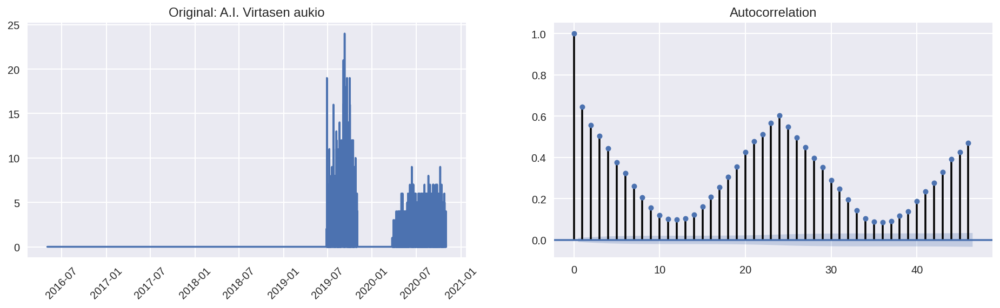

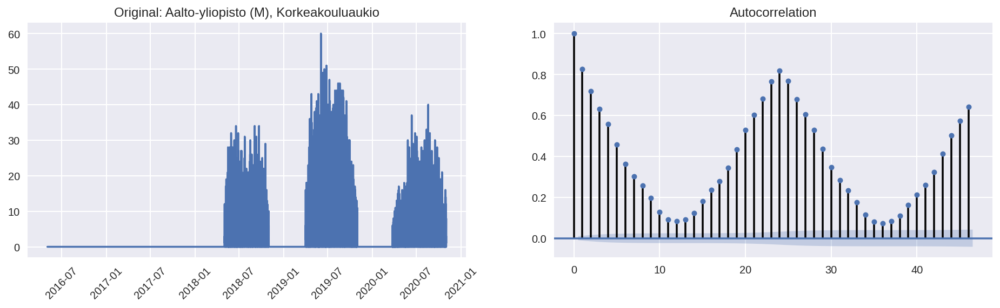

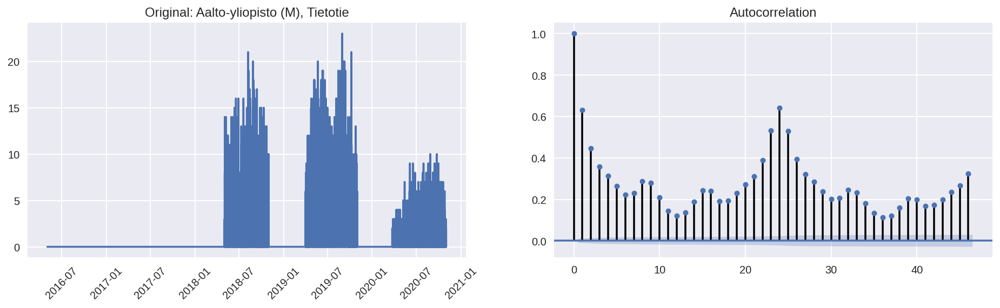

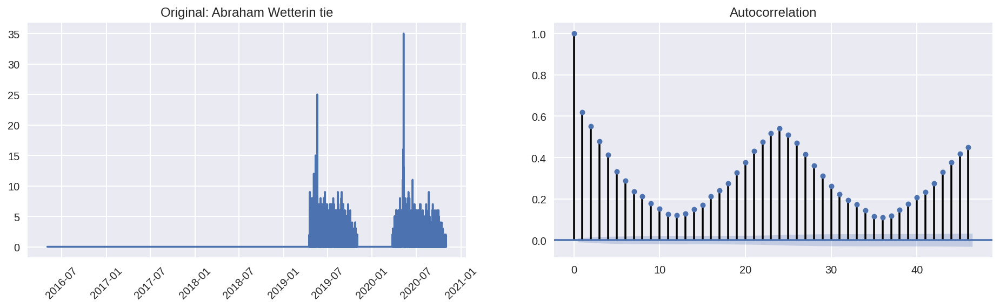

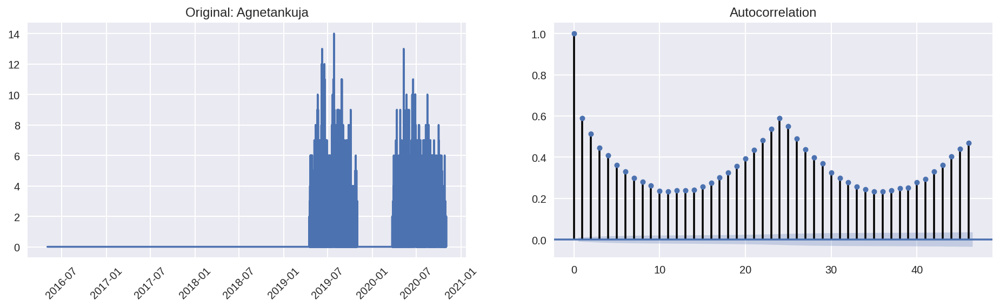

...

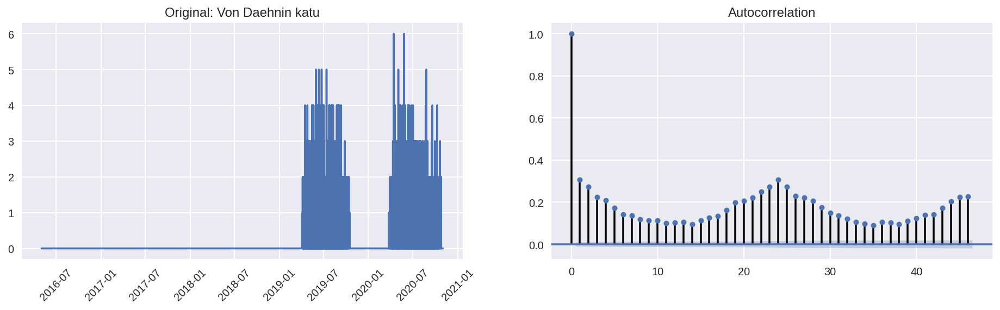

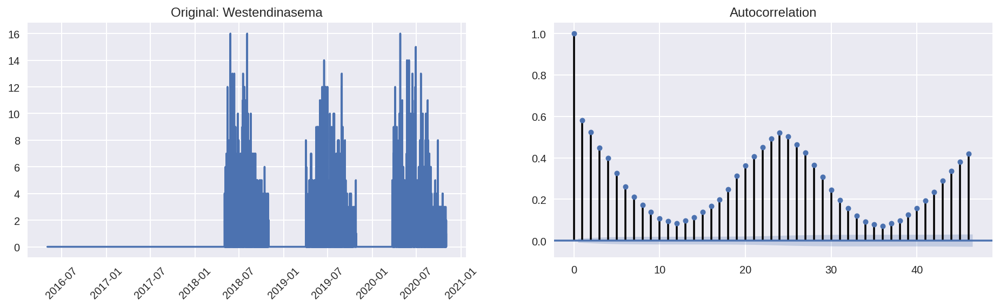

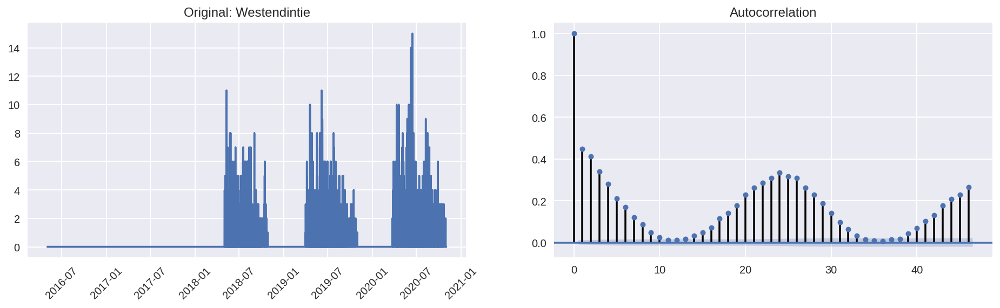

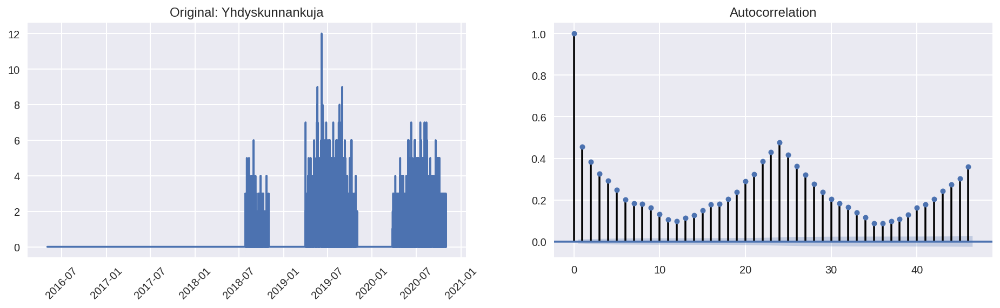

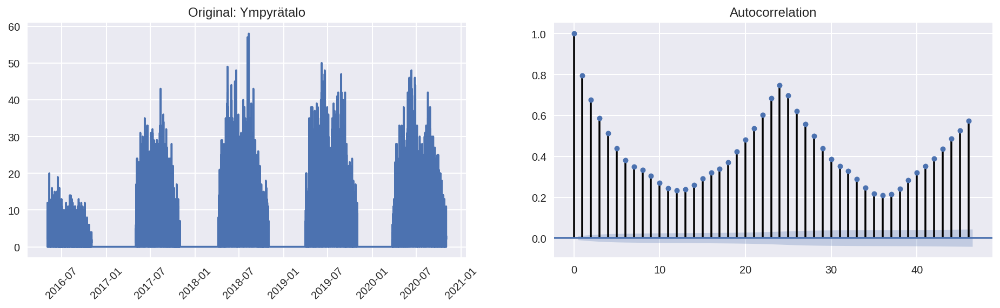

In [ ]:
plot_autocorrelation(all_stations_demand)

### Selecting p: Partial Autocorrelation - the order of auto regressive term

In [ ]:
def plot_partial_autocorrelation(stations_demand):
  for station in stations_demand.columns:

    diff = stations_demand[station].diff().dropna()

    fig, (ax1, ax2) = plt.subplots( 1, 2, figsize=(16,4))
    plt.setp(ax1.get_xticklabels(), rotation=45)
    ax1.plot(diff)
    ax1.set_title(f"Difference one: {station}")
    ax2.set_ylim(0,0.2)
    plot_pacf(diff, ax=ax2)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warnin

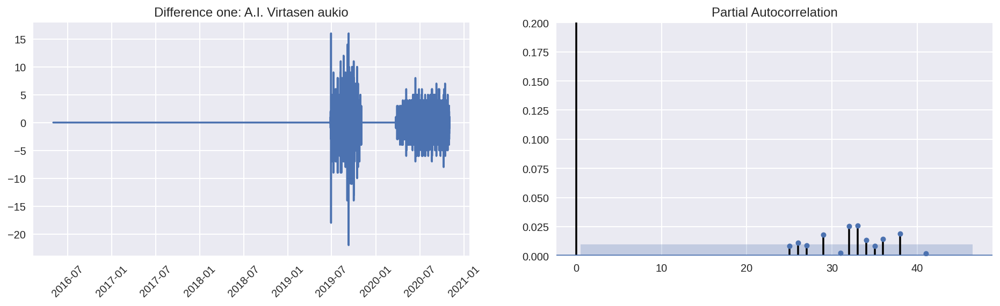

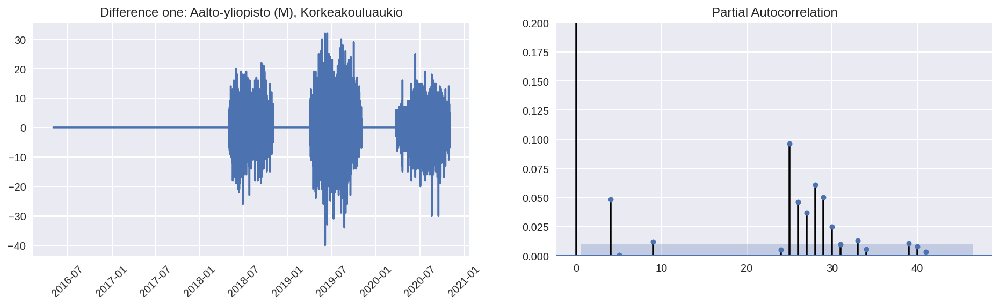

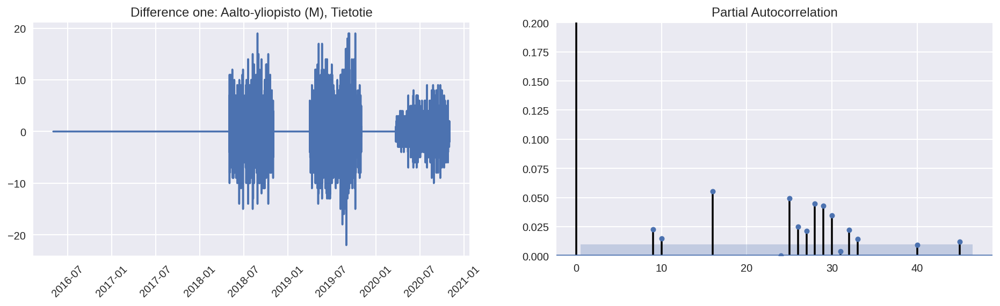

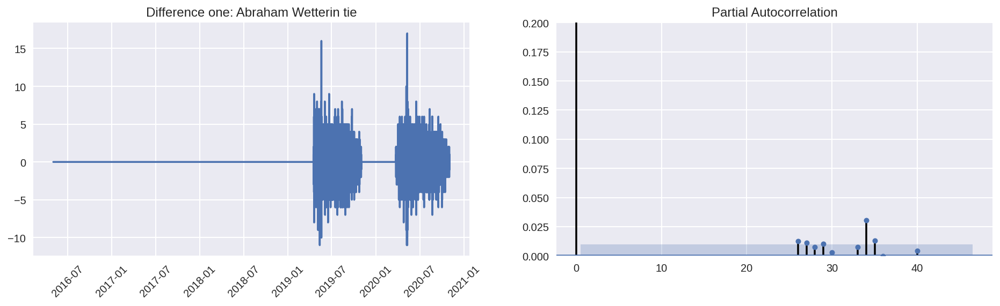

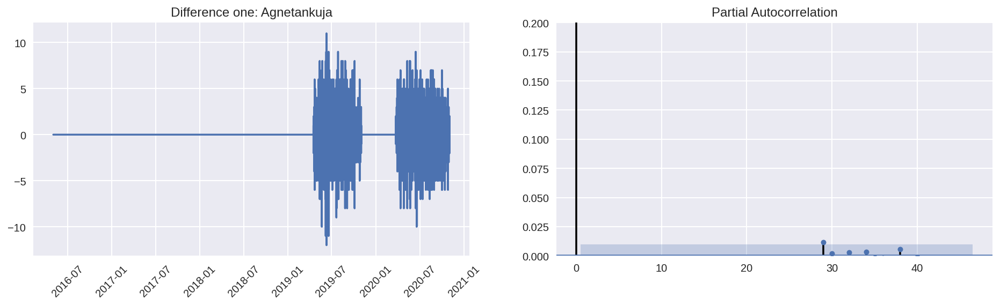

...

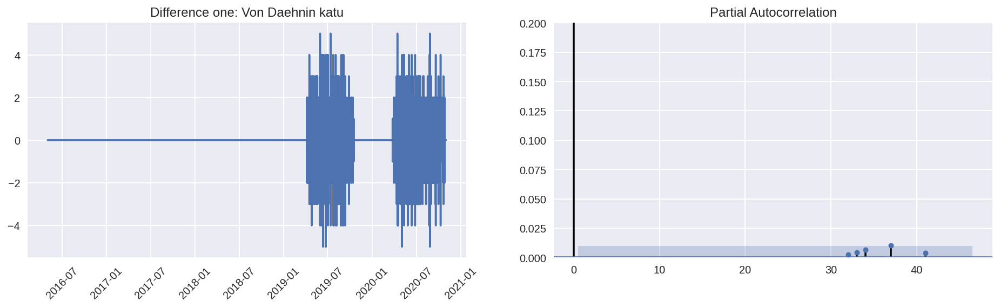

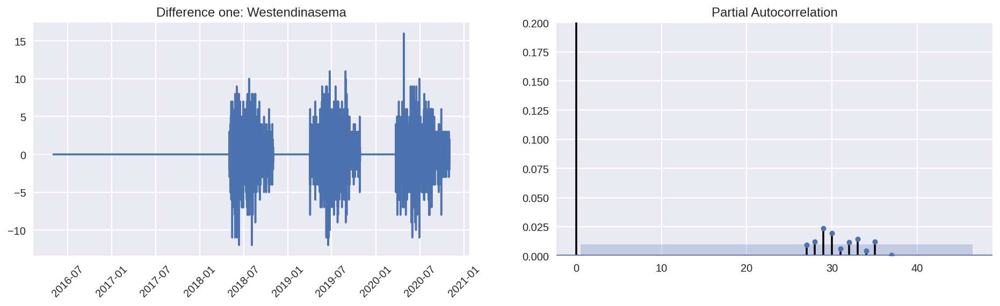

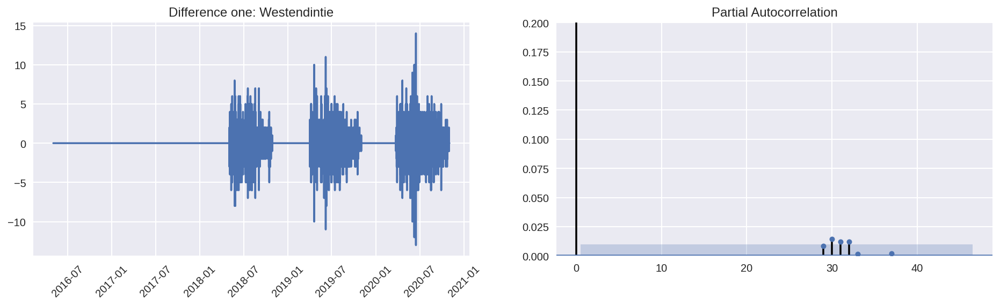

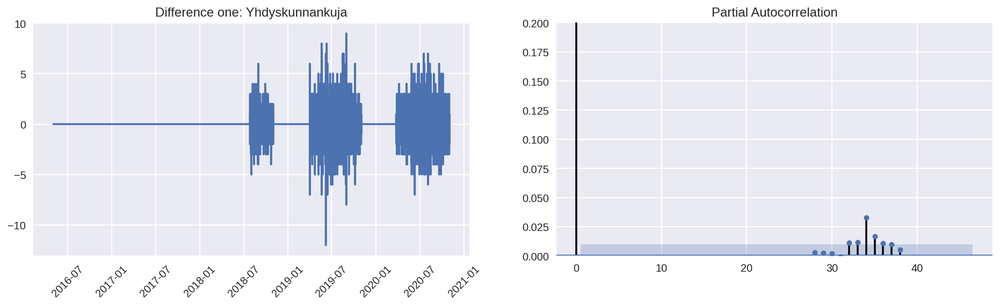

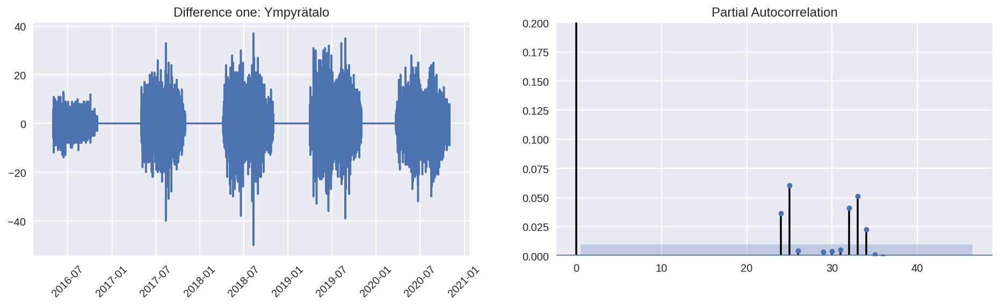

In [ ]:
plot_partial_autocorrelation (all_stations_demand)

In [ ]:
# Get training and testing sets
def train_test_split(data, split_ratio):

    nrow = len(data)
    split_row = int(nrow* split_ratio)
    train = data.iloc[:split_row]
    test = data.iloc[split_row:]

    return train, test

In [ ]:
station = all_stations_demand.columns[1]

In [ ]:
station_demand = all_stations_demand[station]

In [ ]:
train_data, test_data = train_test_split(station_demand, 0.9)

In [ ]:
#def build_ARMA(train_data):

# define model
model = ARMA(train_data, order =(24,30))

#fit the model
model_fit = model.fit()

#summary of the model
print(model_fit.summary())



/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  % freq, ValueWarning)


ValueError: ignored